# Logical model to understand the crypto world

## Libraries

In [222]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import ast
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import matplotlib.patches as mpatches

## Loading full crypto information after preprocessing

In [223]:
df = pd.read_csv('../data/csv/crypto_final.csv')
print(df.shape)
df.head()

(1000, 27)


,id,name,symbol,slug,num_market_pairs,date_added,tags,circulating_supply,total_supply,price,...,exchange_name,exchange_slug,total_weekly_visits,average_weekly_visits,max_weekly_visits,min_weekly_visits,total_spot_volume_usd,average_spot_volume_usd,max_spot_volume_usd,min_spot_volume_usd
0,6535,NEAR Protocol,NEAR,near-protocol,443,2020-08-11T00:00:00.000Z,"platform,ai-big-data,staking,coinbase-ventures...",1.123916e+09,1.209633e+09,4.001789,...,"['Binance', 'DOEX', 'BTCC', 'Bybit', 'DigiFine...","['binance', 'doex', 'btcc', 'bybit', 'digifine...",8.992929e+07,5.839564e+05,10403969.0,44.0,5.948207e+10,3.862472e+08,7.843064e+09,0.000000
1,8916,Internet Computer,ICP,internet-computer,291,2021-03-23T00:00:00.000Z,"platform,ai-big-data,smart-contracts,polychain...",4.698829e+08,5.223637e+08,7.984759,...,"['Binance', 'BTCC', 'Bybit', 'CoinUp.io', 'Dig...","['binance', 'btcc', 'bybit', 'coinup-io', 'dig...",7.725172e+07,7.500167e+05,10403969.0,44.0,5.031126e+10,4.884588e+08,7.843064e+09,0.000000
2,3773,Artificial Superintelligence Alliance,FET,artificial-superintelligence-alliance,370,2019-03-02T00:00:00.000Z,"cosmos-ecosystem,ai-big-data,collectibles-nfts...",2.520000e+09,2.630547e+09,1.298860,...,"['Binance', 'DOEX', 'BTCC', 'Zedcex Exchange',...","['binance', 'doex', 'btcc', 'zedcex-exchange',...",8.521125e+07,7.746477e+05,10403969.0,44.0,5.297546e+10,4.815951e+08,7.843064e+09,0.000000
3,22974,Bittensor,TAO,bittensor,86,2023-03-06T05:20:00.000Z,"ai-big-data,distributed-computing,oracles,dao,...",7.365602e+06,7.365602e+06,277.748222,...,"['Binance', 'Bybit', 'KCEX', 'LBank', 'Toobit'...","['binance', 'bybit', 'kcex', 'lbank', 'toobit'...",6.015005e+07,1.074108e+06,10403969.0,44.0,3.506895e+10,6.262312e+08,7.843064e+09,39184.359981
4,5690,Render,RENDER,render,465,2020-06-11T00:00:00.000Z,"art,media,vr-ar,ai-big-data,distributed-comput...",3.924605e+08,5.322208e+08,5.157754,...,"['Binance', 'Bybit', 'KCEX', 'OKX', 'LBank', '...","['binance', 'bybit', 'kcex', 'okx', 'lbank', '...",5.779923e+07,9.174480e+05,10403969.0,164.0,3.065394e+10,4.865705e+08,7.843064e+09,15071.766165


## Subset

### Cryptos with its exchange lists

In [224]:
crypto_exchange_cols = [
    'id',
    'name',
    'symbol',
    'num_market_pairs', 
    'price',
    'volume_24h',
    'market_cap',
    'category',
    'exchange_id',
    'total_weekly_visits',
    'average_weekly_visits',
    'max_weekly_visits',
    'min_weekly_visits',
    'total_spot_volume_usd',
    'average_spot_volume_usd',
    'max_spot_volume_usd',
    'min_spot_volume_usd'
    ]
crypto_exchange_df = df[crypto_exchange_cols]

crypto_exchange_df.head()

,id,name,symbol,num_market_pairs,price,volume_24h,market_cap,category,exchange_id,total_weekly_visits,average_weekly_visits,max_weekly_visits,min_weekly_visits,total_spot_volume_usd,average_spot_volume_usd,max_spot_volume_usd,min_spot_volume_usd
0,6535,NEAR Protocol,NEAR,443,4.001789,1.896790e+08,4.497676e+09,AI,"[270, 7680, 21, 521, 407, 1188, 9867, 294, 333...",8.992929e+07,5.839564e+05,10403969.0,44.0,5.948207e+10,3.862472e+08,7.843064e+09,0.000000
1,8916,Internet Computer,ICP,291,7.984759,6.524906e+07,3.751901e+09,AI,"[270, 21, 521, 10361, 407, 1188, 9867, 294, 33...",7.725172e+07,7.500167e+05,10403969.0,44.0,5.031126e+10,4.884588e+08,7.843064e+09,0.000000
2,3773,Artificial Superintelligence Alliance,FET,370,1.298860,2.768840e+08,3.273126e+09,AI,"[270, 7680, 21, 9200, 521, 10361, 407, 1188, 9...",8.521125e+07,7.746477e+05,10403969.0,44.0,5.297546e+10,4.815951e+08,7.843064e+09,0.000000
3,22974,Bittensor,TAO,86,277.748222,6.626699e+07,2.045783e+09,AI,"[270, 521, 9867, 333, 6137, 513, 943, 1653, 57...",6.015005e+07,1.074108e+06,10403969.0,44.0,3.506895e+10,6.262312e+08,7.843064e+09,39184.359981
4,5690,Render,RENDER,465,5.157754,8.485562e+07,2.024215e+09,AI,"[270, 521, 9867, 294, 333, 6137, 513, 943, 929...",5.779923e+07,9.174480e+05,10403969.0,164.0,3.065394e+10,4.865705e+08,7.843064e+09,15071.766165


In [225]:
crypto_exchange_df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,1000.0,2.043878e+04,1.041534e+04,1.000000e+00,1.040850e+04,2.365950e+04,2.981675e+04,3.290200e+04
num_market_pairs,1000.0,2.046410e+02,3.178094e+03,1.000000e+00,7.000000e+00,1.800000e+01,4.600000e+01,9.689500e+04
price,1000.0,6.455867e+01,1.815352e+03,3.291000e-21,1.912615e-04,4.231241e-03,7.215153e-02,5.733705e+04
volume_24h,1000.0,1.317790e+08,2.147480e+09,0.000000e+00,2.308008e+03,1.116638e+05,1.258062e+06,5.410084e+10
market_cap,1000.0,1.942201e+09,3.724345e+10,0.000000e+00,0.000000e+00,1.512615e+06,2.354266e+07,1.132571e+12
total_weekly_visits,1000.0,1.709720e+07,2.341853e+07,0.000000e+00,6.243210e+05,7.825504e+06,2.087530e+07,1.021447e+08
average_weekly_visits,1000.0,1.446972e+06,1.303999e+06,0.000000e+00,2.781472e+05,1.232157e+06,2.030374e+06,5.665954e+06
max_weekly_visits,1000.0,4.303202e+06,3.239856e+06,0.000000e+00,3.616000e+05,5.002908e+06,5.665954e+06,1.040397e+07
min_weekly_visits,1000.0,3.840459e+05,1.114142e+06,0.000000e+00,2.180000e+02,3.676900e+04,2.259520e+05,5.665954e+06
total_spot_volume_usd,1000.0,8.675266e+09,1.559108e+10,0.000000e+00,3.858311e+08,1.971617e+09,7.401365e+09,8.055538e+10


In [226]:
crypto_exchange_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       1000 non-null   int64  
 1   name                     1000 non-null   object 
 2   symbol                   1000 non-null   object 
 3   num_market_pairs         1000 non-null   int64  
 4   price                    1000 non-null   float64
 5   volume_24h               1000 non-null   float64
 6   market_cap               1000 non-null   float64
 7   category                 1000 non-null   object 
 8   exchange_id              1000 non-null   object 
 9   total_weekly_visits      1000 non-null   float64
 10  average_weekly_visits    1000 non-null   float64
 11  max_weekly_visits        1000 non-null   float64
 12  min_weekly_visits        1000 non-null   float64
 13  total_spot_volume_usd    1000 non-null   float64
 14  average_spot_volume_usd  

#### Getting the exchanges' ID's

In [227]:
# Convert each string in the 'exchange_id' column to a list
crypto_exchange_df.loc[:, 'exchange_id'] = crypto_exchange_df['exchange_id'].apply(lambda x: ast.literal_eval(x) if isinstance(x, str) else x)

In [228]:
# Concat all lists of exchanges
exchange_ids_list = np.concatenate(crypto_exchange_df['exchange_id'].values.reshape(-1, 1))

# Flatten the list of lists
flattened_exchange_ids = [item for sublist in exchange_ids_list for item in sublist]

# Keeping the unique values
unique_exchanges_ids = set(flattened_exchange_ids)

# Convert it to list
unique_exchanges_ids = list(unique_exchanges_ids)

print('Number of exchanges:', len(unique_exchanges_ids))

Number of exchanges: 523


#### Getting tokens' ID's

In [229]:
token_ids = list(crypto_exchange_df['id'])

print('Number of tokens:', len(token_ids))

Number of tokens: 1000


# Logical models

## Defining general graph properties

In [230]:
# Create a graph
G = nx.Graph()

# Add nodes
for i, row in crypto_exchange_df.iterrows():
    G.add_node(row['id'], symbol=row['symbol'], category=row['category'])

In [231]:
# Add edges with similarity as weight
for i, row1 in crypto_exchange_df.iterrows():
    for j, row2 in crypto_exchange_df.iterrows():
        if i < j:
            # Calculate similarity using Jaccard similarity
            set1 = set(row1['exchange_id'])
            set2 = set(row2['exchange_id'])
            union_set = set1.union(set2)
            if union_set:  # Check if union_set is not empty
                similarity = len(set1.intersection(set2)) / len(union_set)
                if similarity > 0.8:  # Only add edges with high similarity
                    G.add_edge(row1['id'], row2['id'], weight=similarity)

In [232]:
color_map = {
    'AI': '#05f595', # Green
    'Gaming': '#f505a9', # Pink
    'Meme': '#0591f5', # Blue
    'Top': '#d9f505', # Yellow
    'RWA': '#f58105' # Orange
}

node_colors = [color_map[data['category']] for node, data in G.nodes(data=True)]

In [233]:
# Storing edges' weights
edges = G.edges(data=True)
weights =[edge[2]['weight'] for edge in edges]
min(weights)

0.8104089219330854

In [234]:
# Setting up the colors based on the category
norm = mcolors.Normalize(vmin=min(weights), vmax=max(weights))
cmap = cm.plasma
edge_colors = [cmap(norm(weight)) for weight in weights]
legend_patches = [mpatches.Patch(color=color, label=category) for category, color in color_map.items()]
labels = {node: data['symbol'] for node, data in G.nodes(data=True)}

In [235]:
# Graph layout
pos = nx.spring_layout(G, k=15, iterations=1, scale=2, seed=42)

# Create labels dictionary using the symbol attribute
labels = {node: data['symbol'] for node, data in G.nodes(data=True)}

## Logical Models based on the market cap and total spot volume

In [236]:
# Getting the market_cap_list
market_cap_list = list(crypto_exchange_df['market_cap'])
market_cap_list[:5]

[4497676051.325207,
 3751901234.774596,
 3273126160.844951,
 2045782858.712724,
 2024214866.1349893]

In [237]:
# Normalize the market cap to be the size of nodes (300 <= node_size <= 5000)
def normalize_list(lst):
    min_val = min(lst)
    max_val = max(lst)
    normalized_lst = [300 + (5000 - 300) * (x - min_val) / (max_val - min_val) for x in lst]
    return normalized_lst

normalized_market_cap = normalize_list(market_cap_list)
normalized_market_cap[:5]

[318.66468538863467,
 315.5698310321092,
 313.5829858203061,
 308.4896940098841,
 308.4001900546561]

In [238]:
# Get the 3rd quartile in order to increase the size of the top coins with total spot volume
percentile_75_total_spot_volume_usd = crypto_exchange_df['total_spot_volume_usd'].quantile(0.75)
percentile_75_total_spot_volume_usd

7401365272.475449

In [239]:
# Adjust normalized_market_cap based on if the the total_spot_volume_usd is greater than the 3rd quartile, else stays the same
total_adjusted_market_cap = []
for i, row in crypto_exchange_df.iterrows():
    if row['total_spot_volume_usd'] > percentile_75_total_spot_volume_usd:
        total_adjusted_market_cap.append(normalized_market_cap[i] * 4)
    else:
        total_adjusted_market_cap.append(normalized_market_cap[i])

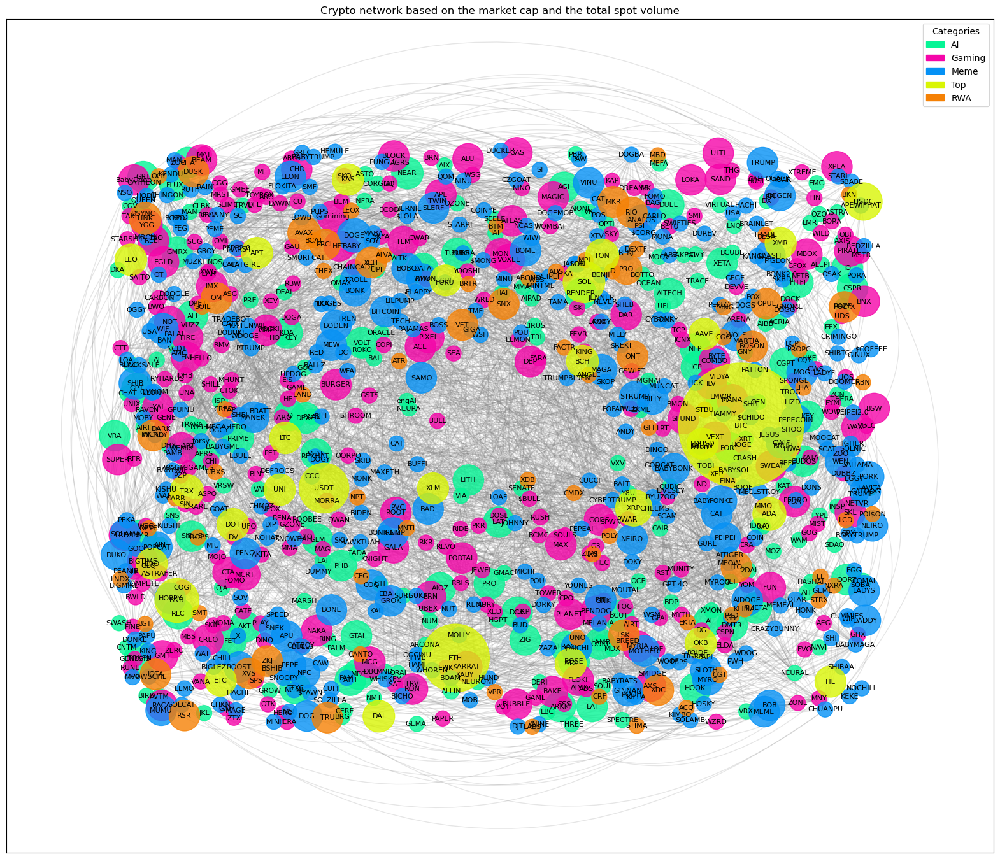

In [240]:
plt.figure(figsize=(20, 17))
nx.draw_networkx_nodes(G, pos, node_size=total_adjusted_market_cap, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1, edge_color='gray', alpha=0.2, connectionstyle="Arc3,rad=0.4", arrows=True)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_weight='normal')
plt.title('Crypto network based on the market cap and the total spot volume')
plt.legend(handles=legend_patches, loc='best', title='Categories')
plt.show()

### Now with the lower nodes staying at a fixed size no see better the difference

In [241]:
# Adjust normalized_market_cap based on if the the total_spot_volume_usd is greater than the 3rd quartile, else sets it to 100
total_adjusted_market_cap_fixed = []
for i, row in crypto_exchange_df.iterrows():
    if row['total_spot_volume_usd'] > percentile_75_total_spot_volume_usd:
        total_adjusted_market_cap_fixed.append(normalized_market_cap[i] * 4)
    else:
        total_adjusted_market_cap_fixed.append(100)

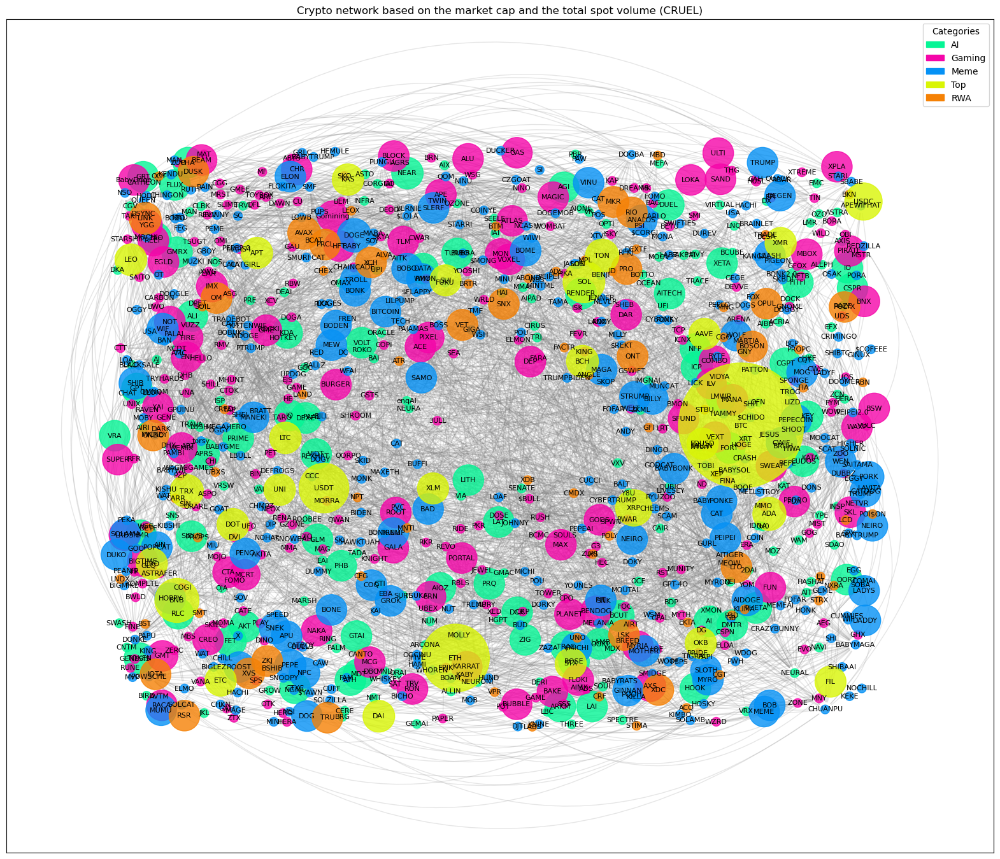

In [242]:
plt.figure(figsize=(20, 17))
nx.draw_networkx_nodes(G, pos, node_size=total_adjusted_market_cap_fixed, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1, edge_color='gray', alpha=0.2, connectionstyle="Arc3,rad=0.4", arrows=True)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_weight='normal')
plt.legend(handles=legend_patches, loc='best', title='Categories')
plt.title('Crypto network based on the market cap and the total spot volume (CRUEL)')
plt.show()

## Logical Model based on the market cap and the average spot volume

In [243]:
# Getting the average of the average spot volume
avg_average_spot_volume_usd = crypto_exchange_df['average_spot_volume_usd'].mean()
avg_average_spot_volume_usd

452823339.5338652

In [244]:
# Adjust normalized_market_cap based on if the the total_spot_volume_usd is greater than the 3rd quartile, else stays the same
average_adjusted_market_cap = []
for i, row in crypto_exchange_df.iterrows():
    if row['average_spot_volume_usd'] > avg_average_spot_volume_usd:
        average_adjusted_market_cap.append(normalized_market_cap[i] * 4)
    else:
        average_adjusted_market_cap.append(normalized_market_cap[i])

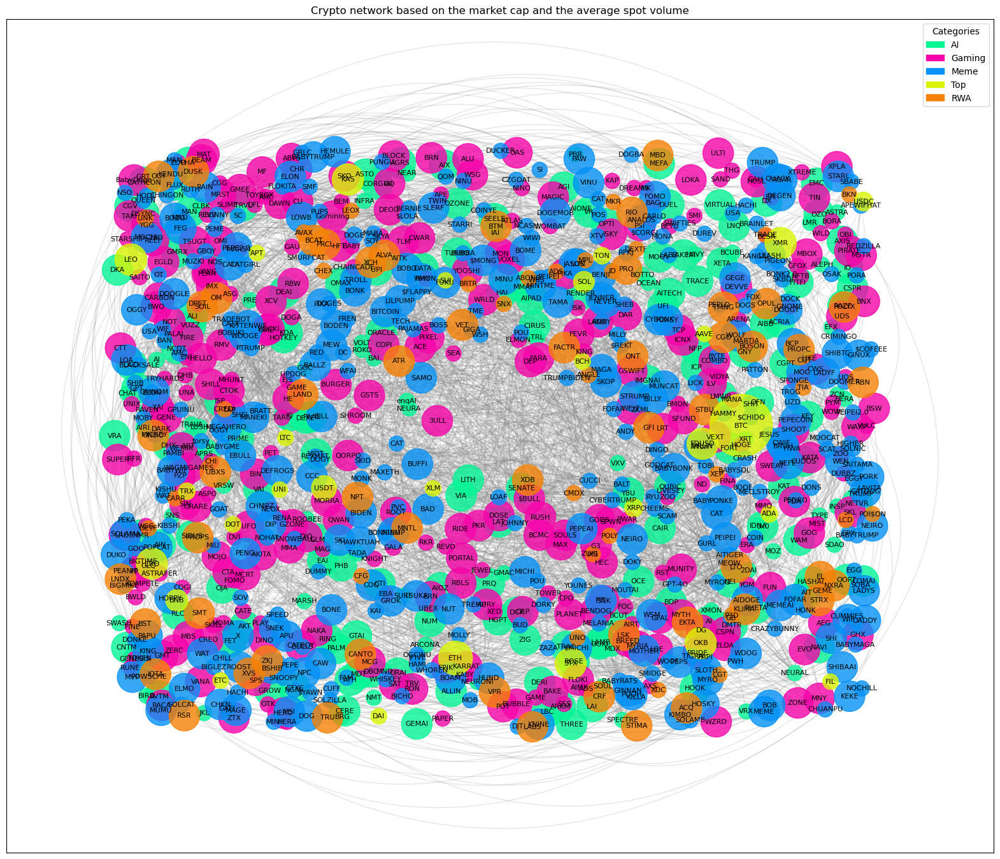

In [245]:
plt.figure(figsize=(20, 17))
nx.draw_networkx_nodes(G, pos, node_size=average_adjusted_market_cap, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1, edge_color='gray', alpha=0.2, connectionstyle="Arc3,rad=0.4", arrows=True)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_weight='normal')
plt.legend(handles=legend_patches, loc='best', title='Categories')
plt.title('Crypto network based on the market cap and the average spot volume')
plt.show()

### Now with the lower nodes staying at a fixed size no see better the difference

In [246]:
# Adjust normalized_market_cap based on if the the total_spot_volume_usd is greater than the 3rd quartile, else is set to 100
average_adjusted_market_cap_fixed = []
for i, row in crypto_exchange_df.iterrows():
    if row['average_spot_volume_usd'] > avg_average_spot_volume_usd:
        average_adjusted_market_cap_fixed.append(normalized_market_cap[i] * 4)
    else:
        average_adjusted_market_cap_fixed.append(100)

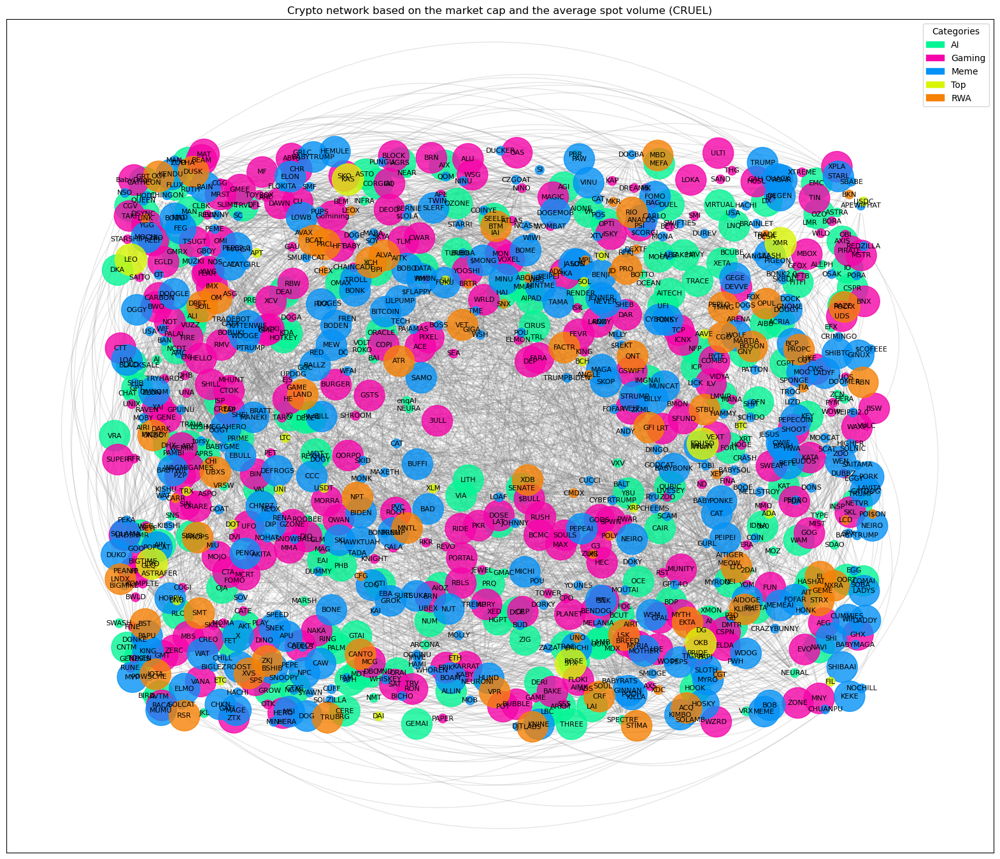

In [247]:
plt.figure(figsize=(20, 17))
nx.draw_networkx_nodes(G, pos, node_size=average_adjusted_market_cap_fixed, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1, edge_color='gray', alpha=0.2, connectionstyle="Arc3,rad=0.4", arrows=True)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_weight='normal')
plt.legend(handles=legend_patches, loc='best', title='Categories')
plt.title('Crypto network based on the market cap and the average spot volume (CRUEL)')
plt.show()

## Logical Model based on the market cap and the total weekly visits

In [248]:
# Getting the total weekly visits
percentil_75_total_weekly_visits = crypto_exchange_df['total_weekly_visits'].quantile(0.75)
percentil_75_total_weekly_visits

20875301.5

In [249]:
# Adjust normalized_market_cap based on if the the total_weekly_visits is greater than the 3rd quartile, else stays the same
total_visits_adjusted_market_cap = []
for i, row in crypto_exchange_df.iterrows():
    if row['total_weekly_visits'] > percentil_75_total_weekly_visits:
        total_visits_adjusted_market_cap.append(normalized_market_cap[i] * 4)
    else:
        total_visits_adjusted_market_cap.append(normalized_market_cap[i])

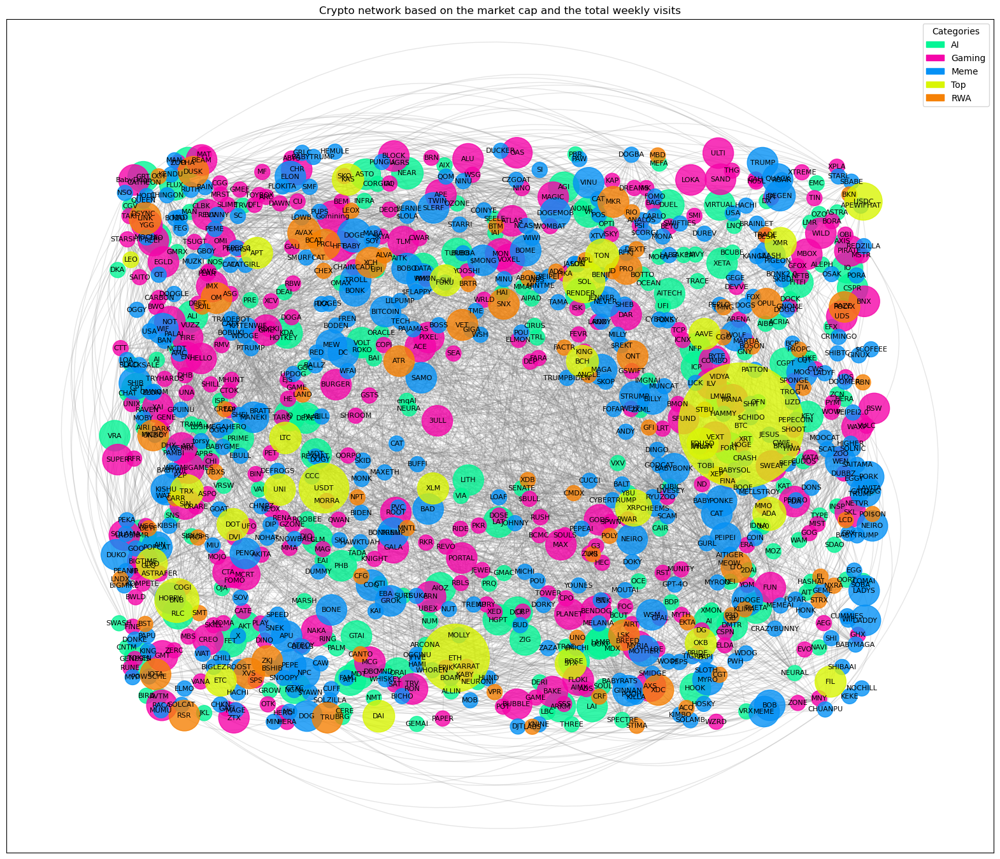

In [250]:
plt.figure(figsize=(20, 17))
nx.draw_networkx_nodes(G, pos, node_size=total_visits_adjusted_market_cap, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1, edge_color='gray', alpha=0.2, connectionstyle="Arc3,rad=0.4", arrows=True)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_weight='normal')
plt.legend(handles=legend_patches, loc='best', title='Categories')
plt.title('Crypto network based on the market cap and the total weekly visits')
plt.show()

### Now with the lower nodes staying at a fixed size no see better the difference

In [251]:
# Adjust normalized_market_cap based on if the the total_weekly_visits is greater than the 3rd quartile, else is set to 100
total_visits_adjusted_market_cap_fixed = []
for i, row in crypto_exchange_df.iterrows():
    if row['total_weekly_visits'] > percentil_75_total_weekly_visits:
        total_visits_adjusted_market_cap_fixed.append(normalized_market_cap[i] * 4)
    else:
        total_visits_adjusted_market_cap_fixed.append(100)

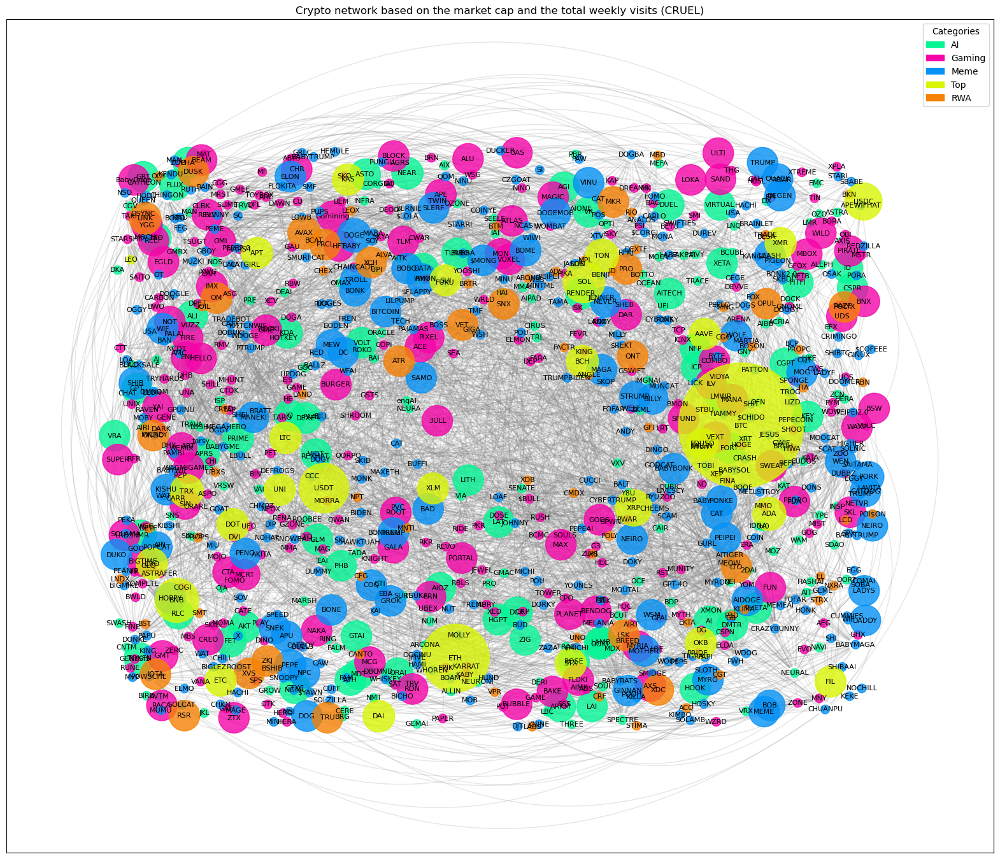

In [252]:
plt.figure(figsize=(20, 17))
nx.draw_networkx_nodes(G, pos, node_size=total_visits_adjusted_market_cap_fixed, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1, edge_color='gray', alpha=0.2, connectionstyle="Arc3,rad=0.4", arrows=True)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_weight='normal')
plt.legend(handles=legend_patches, loc='best', title='Categories')
plt.title('Crypto network based on the market cap and the total weekly visits (CRUEL)')
plt.show()

## Logical Model based on the market cap and the total weekly visits

In [253]:
# Getting the average weekly visits
avg_average_weekly_visits = crypto_exchange_df['average_weekly_visits'].mean()
avg_average_weekly_visits

1446971.7939963043

In [254]:
# Adjust normalized_market_cap based on if the the average_weekly_vists is greater than the mean, else stays the same
average_visits_adjusted_market_cap = []
for i, row in crypto_exchange_df.iterrows():
    if row['average_weekly_visits'] > avg_average_weekly_visits:
        average_visits_adjusted_market_cap.append(normalized_market_cap[i] * 4)
    else:
        average_visits_adjusted_market_cap.append(normalized_market_cap[i])

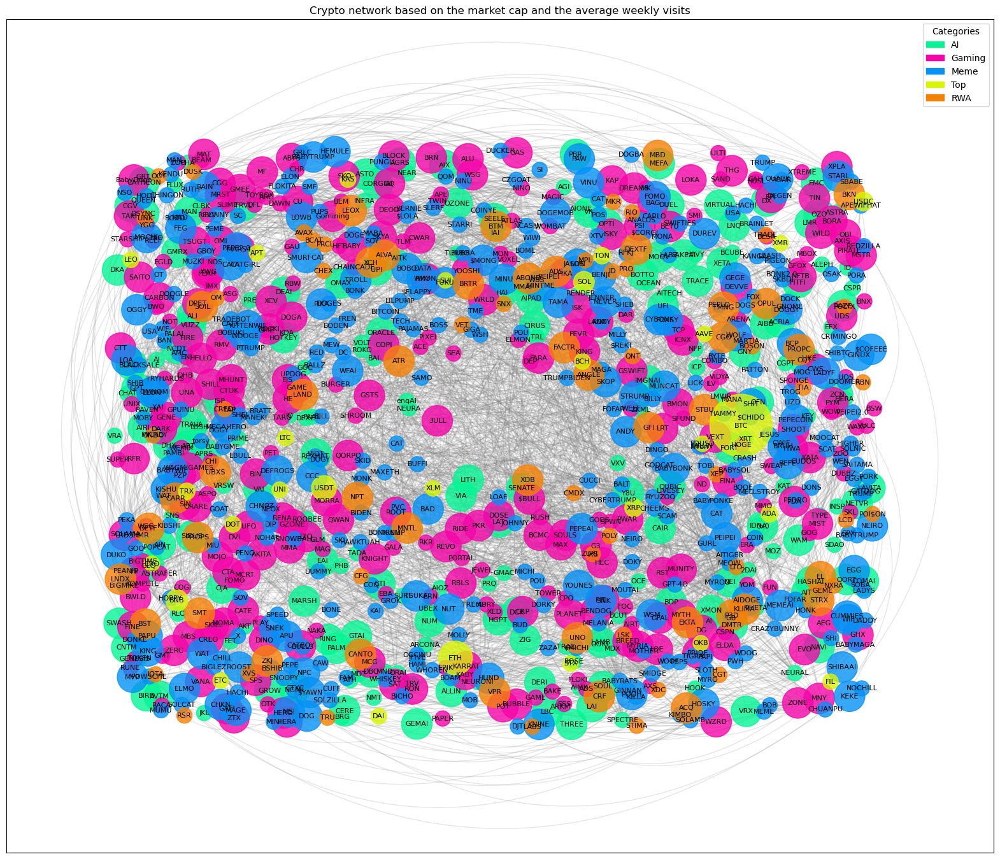

In [255]:
plt.figure(figsize=(20, 17))
nx.draw_networkx_nodes(G, pos, node_size=average_visits_adjusted_market_cap, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1, edge_color='gray', alpha=0.2, connectionstyle="Arc3,rad=0.4", arrows=True)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_weight='normal')
plt.legend(handles=legend_patches, loc='best', title='Categories')
plt.title('Crypto network based on the market cap and the average weekly visits')
plt.show()

### Now with the lower nodes staying at a fixed size no see better the difference

In [256]:
# Adjust normalized_market_cap based on if the the total_weekly_visits is greater than the 3rd quartile, else is set to 100
average_visits_adjusted_market_cap_fixed = []
for i, row in crypto_exchange_df.iterrows():
    if row['average_weekly_visits'] > avg_average_weekly_visits:
        average_visits_adjusted_market_cap_fixed.append(normalized_market_cap[i] * 4)
    else:
        average_visits_adjusted_market_cap_fixed.append(100)

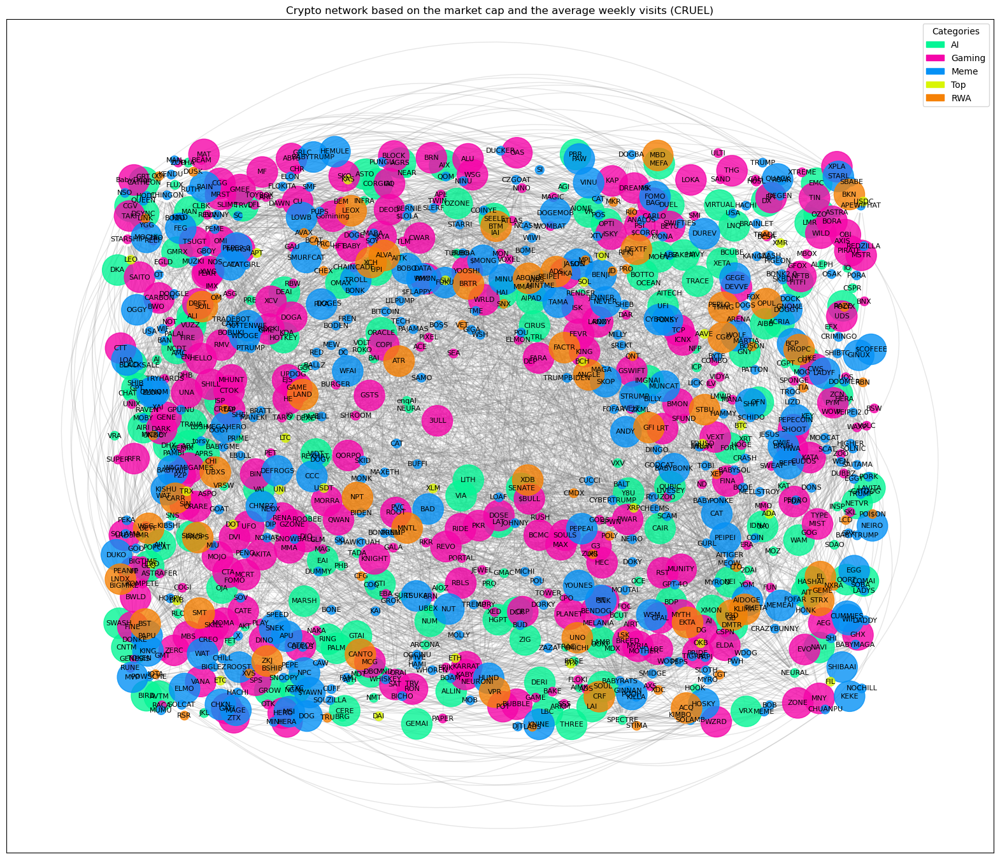

In [257]:
plt.figure(figsize=(20, 17))
nx.draw_networkx_nodes(G, pos, node_size=average_visits_adjusted_market_cap_fixed, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1, edge_color='gray', alpha=0.2, connectionstyle="Arc3,rad=0.4", arrows=True)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_weight='normal')
plt.legend(handles=legend_patches, loc='best', title='Categories')
plt.title('Crypto network based on the market cap and the average weekly visits (CRUEL)')
plt.show()

## Logical model based on highly similar tokens based on exchanges

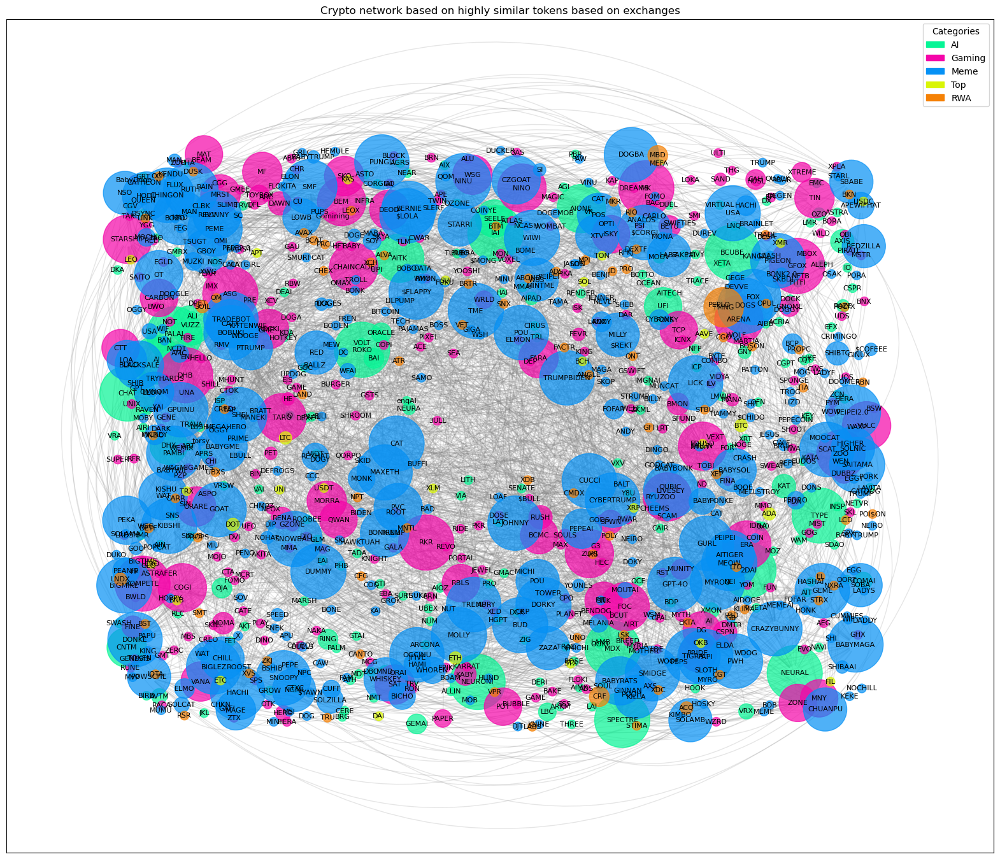

In [258]:
# Calculate node sizes based on degree
node_sizes = [100 + 100 * G.degree(node) for node in G.nodes()]

plt.figure(figsize=(20, 17))
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color=node_colors, alpha=0.7)
nx.draw_networkx_edges(G, pos, width=weights, edge_color='gray', alpha=0.2, connectionstyle="Arc3,rad=0.4", arrows=True)
nx.draw_networkx_labels(G, pos, labels=labels, font_size=8, font_weight='normal')
plt.legend(handles=legend_patches, loc='best', title='Categories')
plt.title('Crypto network based on highly similar tokens based on exchanges')
plt.show()